<a href="https://colab.research.google.com/github/andysingal/AutoEncoders/blob/main/GAN/conditionalgan.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Implementing conditional GANs
Imagine a scenario where we want to generate an image of a class of our interest; for example, an image of a cat or an image of a dog, or an image of a man with spectacles. How do we specify that we want to generate an image of interest to us? Conditional GANs come to the rescue in this scenario.

For now, let's assume that we have the images of male and female faces only along with their corresponding labels. In this section, we will learn about generating images of a specified class of interest from random noise.

The strategy we adopt is as follows:

- Specify the label of the image we want to generate as a one-hot-encoded version.
- Pass the label through an embedding layer to generate a multi-dimensional representation of each class.
- Generate random noise and concatenate with the embedding layer generated in the previous step.
- Train the model just like we did in the previous sections, but this time with the noise vector concatenated with the embedding of the class of image we wish to generate.

In [ ]:
!wget https://www.dropbox.com/s/rbajpdlh7efkdo1/male_female_face_images.zip
!unzip -q male_female_face_images.zip


--2023-06-17 07:29:47--  https://www.dropbox.com/s/rbajpdlh7efkdo1/male_female_face_images.zip
Resolving www.dropbox.com (www.dropbox.com)... 162.125.4.18, 2620:100:6019:18::a27d:412
Connecting to www.dropbox.com (www.dropbox.com)|162.125.4.18|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: /s/raw/rbajpdlh7efkdo1/male_female_face_images.zip [following]
--2023-06-17 07:29:47--  https://www.dropbox.com/s/raw/rbajpdlh7efkdo1/male_female_face_images.zip
Reusing existing connection to www.dropbox.com:443.
HTTP request sent, awaiting response... 302 Found
Location: https://uc3981bb1bc83db8fc611ef0b770.dl.dropboxusercontent.com/cd/0/inline/B-J2hHohoxbe_hp0OKZr8uT2utYgwuvTfrEzeVAW03ISL1art1uJTzkUlmmIeZNNLOvuq3-7uhQGpFrqM7dncLVNHVKXFDo1HutHEeb99PKamUbC0nBYbb_AyAbA7nBcPIbcTryVVkXKLOvsi7satYmkN34FXy1Jyaw_zIbQMt6u9Q/file# [following]
--2023-06-17 07:29:47--  https://uc3981bb1bc83db8fc611ef0b770.dl.dropboxusercontent.com/cd/0/inline/B-J2hHohoxbe_hp0OKZr8uT2utYgwuvTfrE

In [ ]:
!pip install -q --upgrade torch_snippets
from torch_snippets import *
device = "cuda" if torch.cuda.is_available() else "cpu"
from torchvision.utils import make_grid
from torch_snippets import *
from PIL import Image
import torchvision
from torchvision import transforms
import torchvision.utils as vutils

In [ ]:
female_images = Glob('/content/females/*.jpg')
male_images = Glob('/content/males/*.jpg')

In [ ]:
face_cascade = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')

In [ ]:
!mkdir cropped_faces_female
!mkdir cropped_faces_male
for i in range(len(female_images)):
    img = read(female_images[i],1)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    faces = face_cascade.detectMultiScale(gray, 1.3, 5)
    for (x,y,w,h) in faces:
        img2 = img[y:(y+h),x:(x+w),:]
    cv2.imwrite('cropped_faces_female/'+str(i)+'.jpg',cv2.cvtColor(img2, cv2.COLOR_RGB2BGR))
for i in range(len(male_images)):
    img = read(male_images[i],1)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    faces = face_cascade.detectMultiScale(gray, 1.3, 5)
    for (x,y,w,h) in faces:
        img2 = img[y:(y+h),x:(x+w),:]
    cv2.imwrite('cropped_faces_male/'+str(i)+'.jpg',cv2.cvtColor(img2, cv2.COLOR_RGB2BGR))

mkdir: cannot create directory ‘cropped_faces_female’: File exists
mkdir: cannot create directory ‘cropped_faces_male’: File exists


In [ ]:
transform=transforms.Compose([
                               transforms.Resize(64),
                               transforms.CenterCrop(64),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ])

In [ ]:
class Faces(Dataset):
    def __init__(self, folders):
        super().__init__()
        self.folderfemale = folders[0]
        self.foldermale = folders[1]
        self.images=sorted(Glob(self.folderfemale))+sorted(Glob(self.foldermale))
    def __len__(self):
        return len(self.images)
    def __getitem__(self, ix):
        image_path = self.images[ix]
        image = Image.open(image_path)
        image = transform(image)
        gender = np.where('female' in str(image_path),1,0)
        return image, torch.tensor(gender).long()

In [ ]:
ds = Faces(folders=['cropped_faces_female', 'cropped_faces_male'])
dataloader = DataLoader(ds, batch_size=64, shuffle=True, num_workers=8)



Define the weight initialization method so that we do not have a widespread variation across randomly initialized weight values:

In [ ]:

def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [ ]:

class Discriminator(nn.Module):
    def __init__(self, emb_size=32):
        super(Discriminator, self).__init__()
        self.emb_size = 32
        self.label_embeddings = nn.Embedding(2, self.emb_size)
        self.model = nn.Sequential(
            nn.Conv2d(3,64,4,2,1,bias=False),
            nn.LeakyReLU(0.2,inplace=True),
            nn.Conv2d(64,64*2,4,2,1,bias=False),
            nn.BatchNorm2d(64*2),
            nn.LeakyReLU(0.2,inplace=True),
            nn.Conv2d(64*2,64*4,4,2,1,bias=False),
            nn.BatchNorm2d(64*4),
            nn.LeakyReLU(0.2,inplace=True),
            nn.Conv2d(64*4,64*8,4,2,1,bias=False),
            nn.BatchNorm2d(64*8),
            nn.LeakyReLU(0.2,inplace=True),
            nn.Conv2d(64*8,64,4,2,1,bias=False),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(0.2,inplace=True),
            nn.Flatten()
        )
        self.model2 = nn.Sequential(
            nn.Linear(288,100),
            nn.LeakyReLU(0.2,inplace=True),
            nn.Linear(100,1),
            nn.Sigmoid()
        )
        self.apply(weights_init)
    def forward(self, input, labels):
        x = self.model(input)
        y = self.label_embeddings(labels)
        input = torch.cat([x, y], 1)
        final_output = self.model2(input)
        return final_output


In [ ]:
!pip install torch_summary
from torchsummary import summary
discriminator = Discriminator().to(device)
summary(discriminator,torch.zeros(32,3,64,64).to(device), torch.zeros(32).long().to(device));

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Layer (type:depth-idx)                   Output Shape              Param #
├─Sequential: 1-1                        [-1, 256]                 --
|    └─Conv2d: 2-1                       [-1, 64, 32, 32]          3,072
|    └─LeakyReLU: 2-2                    [-1, 64, 32, 32]          --
|    └─Conv2d: 2-3                       [-1, 128, 16, 16]         131,072
|    └─BatchNorm2d: 2-4                  [-1, 128, 16, 16]         256
|    └─LeakyReLU: 2-5                    [-1, 128, 16, 16]         --
|    └─Conv2d: 2-6                       [-1, 256, 8, 8]           524,288
|    └─BatchNorm2d: 2-7                  [-1, 256, 8, 8]           512
|    └─LeakyReLU: 2-8                    [-1, 256, 8, 8]           --
|    └─Conv2d: 2-9                       [-1, 512, 4, 4]           2,097,152
|    └─BatchNorm2d: 2-10                 [-1, 512, 4, 4]           1,024
|    └─LeakyReLU: 2-11         

In [ ]:
class Generator(nn.Module):
    def __init__(self, emb_size=32):
        super(Generator,self).__init__()
        self.emb_size = emb_size
        self.label_embeddings = nn.Embedding(2, self.emb_size)
        self.model = nn.Sequential(
            nn.ConvTranspose2d(100+self.emb_size,64*8,4,1,0,bias=False),
            nn.BatchNorm2d(64*8),
            nn.ReLU(True),
            nn.ConvTranspose2d(64*8,64*4,4,2,1,bias=False),
            nn.BatchNorm2d(64*4),
            nn.ReLU(True),
            nn.ConvTranspose2d(64*4,64*2,4,2,1,bias=False),
            nn.BatchNorm2d(64*2),
            nn.ReLU(True),
            nn.ConvTranspose2d(64*2,64,4,2,1,bias=False),
            nn.BatchNorm2d(64),
            nn.ReLU(True),
            nn.ConvTranspose2d(64,3,4,2,1,bias=False),
            nn.Tanh()
        )
        self.apply(weights_init)
    def forward(self,input_noise,labels):
        label_embeddings = self.label_embeddings(labels).view(len(labels), self.emb_size, 1, 1)
        input = torch.cat([input_noise, label_embeddings], 1)
        return self.model(input)

In [ ]:
generator = Generator().to(device)
summary(generator,torch.zeros(32,100,1,1).to(device), torch.zeros(32).long().to(device));

Layer (type:depth-idx)                   Output Shape              Param #
├─Embedding: 1-1                         [-1, 32]                  64
├─Sequential: 1-2                        [-1, 3, 64, 64]           --
|    └─ConvTranspose2d: 2-1              [-1, 512, 4, 4]           1,081,344
|    └─BatchNorm2d: 2-2                  [-1, 512, 4, 4]           1,024
|    └─ReLU: 2-3                         [-1, 512, 4, 4]           --
|    └─ConvTranspose2d: 2-4              [-1, 256, 8, 8]           2,097,152
|    └─BatchNorm2d: 2-5                  [-1, 256, 8, 8]           512
|    └─ReLU: 2-6                         [-1, 256, 8, 8]           --
|    └─ConvTranspose2d: 2-7              [-1, 128, 16, 16]         524,288
|    └─BatchNorm2d: 2-8                  [-1, 128, 16, 16]         256
|    └─ReLU: 2-9                         [-1, 128, 16, 16]         --
|    └─ConvTranspose2d: 2-10             [-1, 64, 32, 32]          131,072
|    └─BatchNorm2d: 2-11                 [-1, 64, 32, 32

In [ ]:
def noise(size):
    n = torch.randn(size, 100, 1, 1, device=device)
    return n.to(device)



In [ ]:
def discriminator_train_step(real_data, real_labels, fake_data, fake_labels):
    d_optimizer.zero_grad()
    prediction_real = discriminator(real_data, real_labels)
    error_real = loss(prediction_real, torch.ones(len(real_data), 1).to(device))
    error_real.backward()
    prediction_fake = discriminator(fake_data, fake_labels)
    error_fake = loss(prediction_fake, torch.zeros(len(fake_data), 1).to(device))
    error_fake.backward()
    d_optimizer.step()
    return error_real + error_fake

In [ ]:
def generator_train_step(fake_data, fake_labels):
    g_optimizer.zero_grad()
    prediction = discriminator(fake_data, fake_labels)
    error = loss(prediction, torch.ones(len(fake_data), 1).to(device))
    error.backward()
    g_optimizer.step()
    return error

In [ ]:
discriminator = Discriminator().to(device)
generator = Generator().to(device)
loss = nn.BCELoss()
d_optimizer = optim.Adam(discriminator.parameters(), lr=0.0002, betas=(0.5, 0.999))
g_optimizer = optim.Adam(generator.parameters(), lr=0.0002, betas=(0.5, 0.999))
fixed_noise = torch.randn(64, 100, 1, 1, device=device)
fixed_fake_labels = torch.LongTensor([0]*(len(fixed_noise)//2) + [1]*(len(fixed_noise)//2)).to(device)
loss = nn.BCELoss()
n_epochs = 25
img_list = []

EPOCH: 1.000  g_loss: 2.735  d_loss: 0.632  (42.82s - 1027.77s remaining)


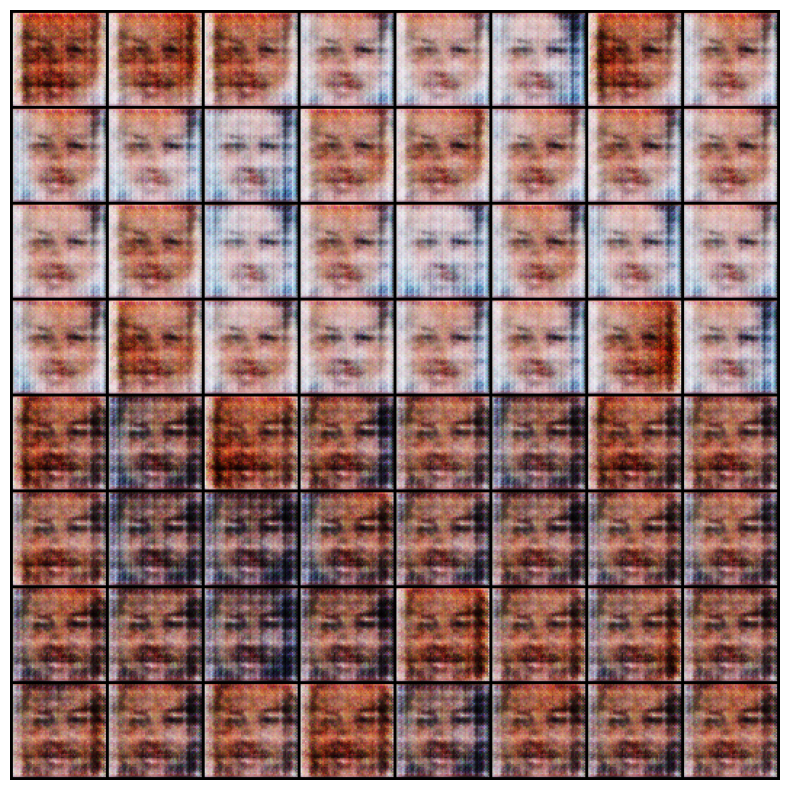

EPOCH: 2.000  g_loss: 3.897  d_loss: 0.560  (85.22s - 979.98s remaining)


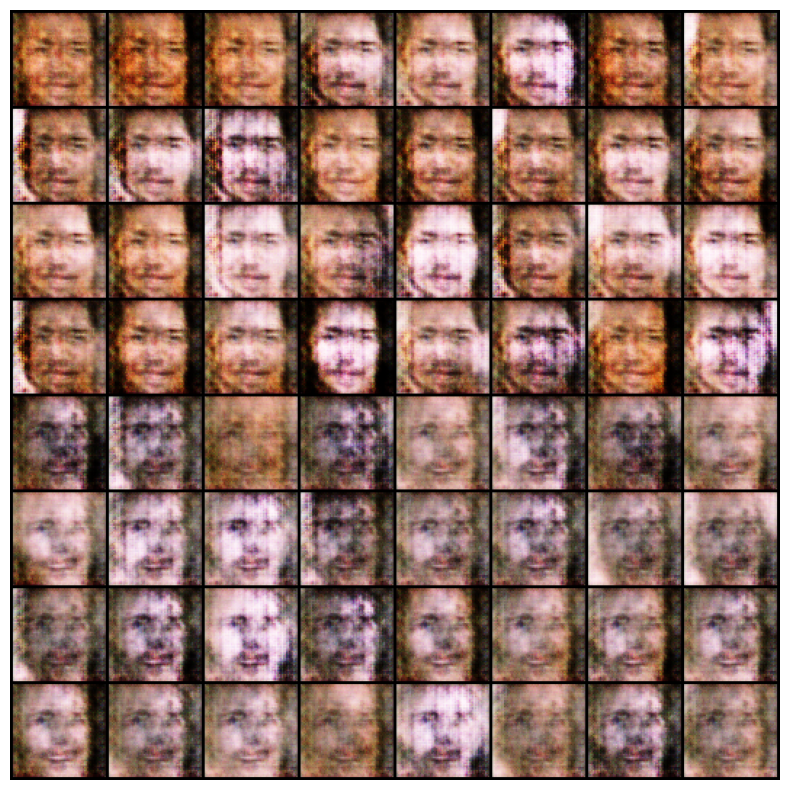

EPOCH: 3.000  g_loss: 4.525  d_loss: 0.490  (129.17s - 947.24s remaining)


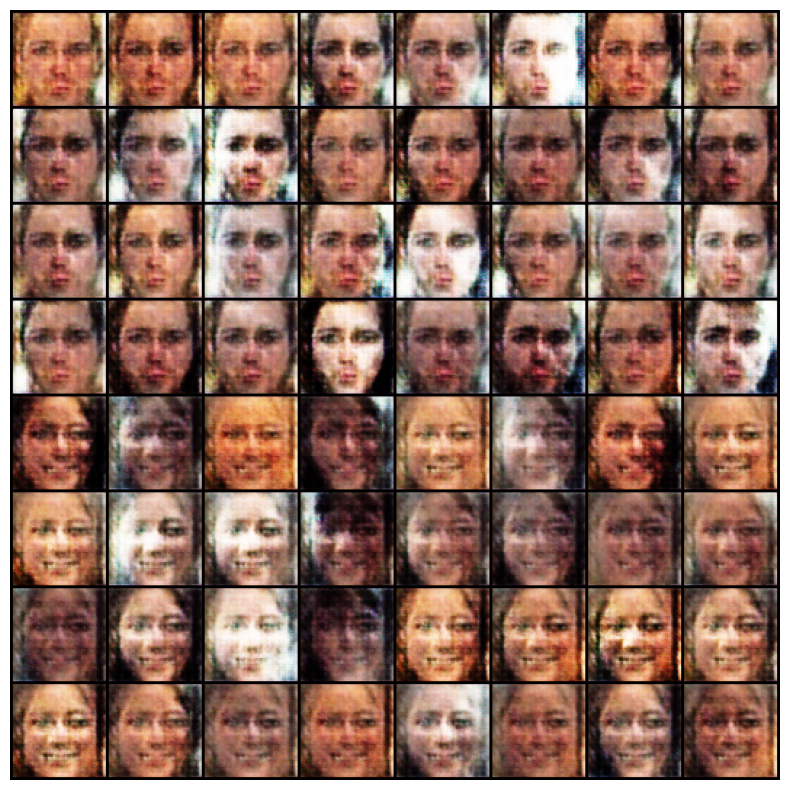

EPOCH: 4.000  g_loss: 4.999  d_loss: 0.424  (174.09s - 914.00s remaining)


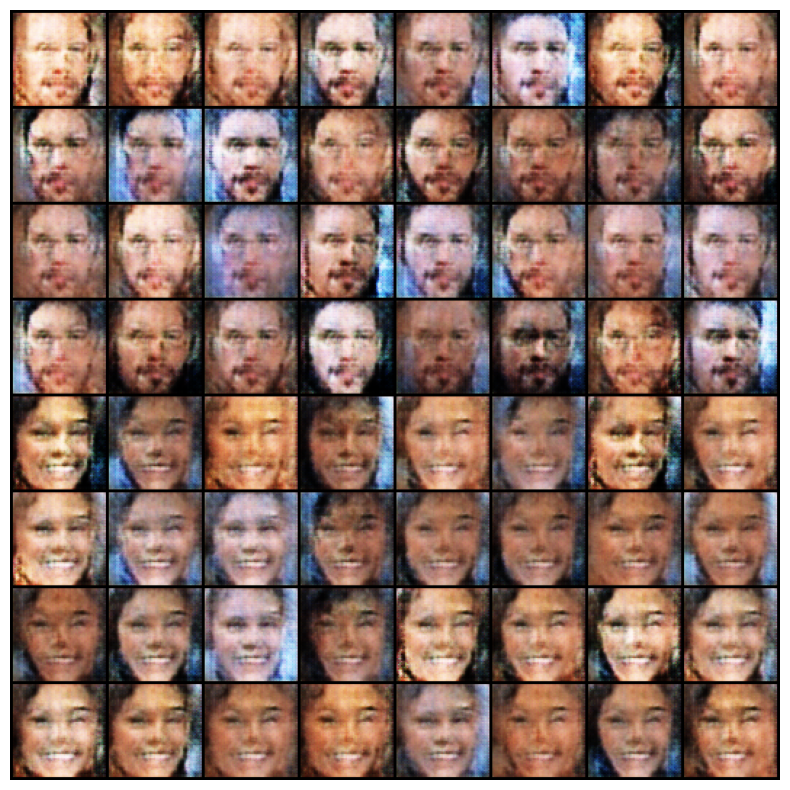

EPOCH: 5.000  g_loss: 5.116  d_loss: 0.496  (220.98s - 883.93s remaining)


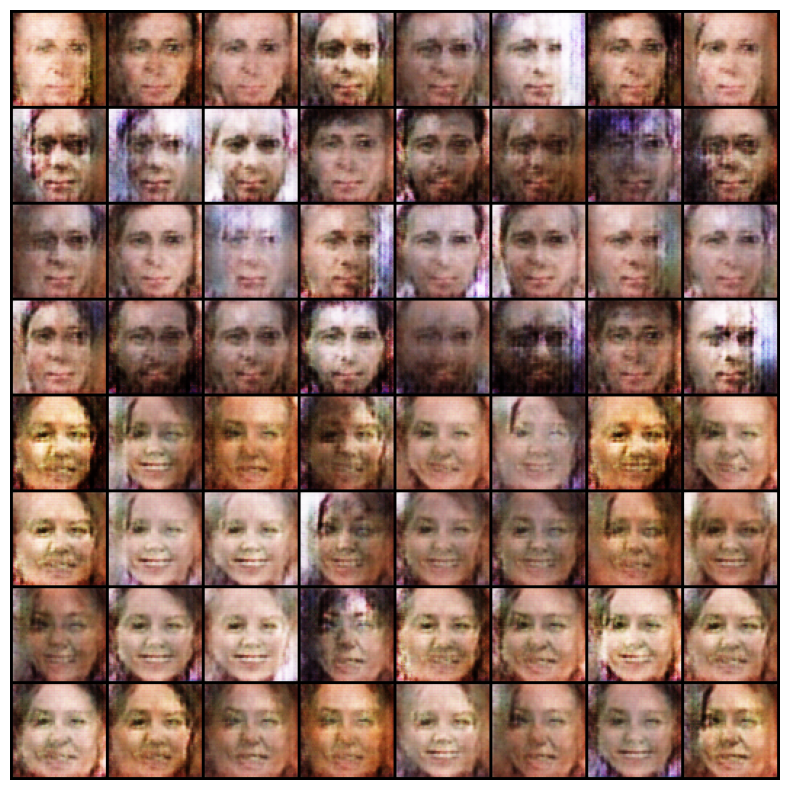

EPOCH: 6.000  g_loss: 4.956  d_loss: 0.476  (270.60s - 856.90s remaining)


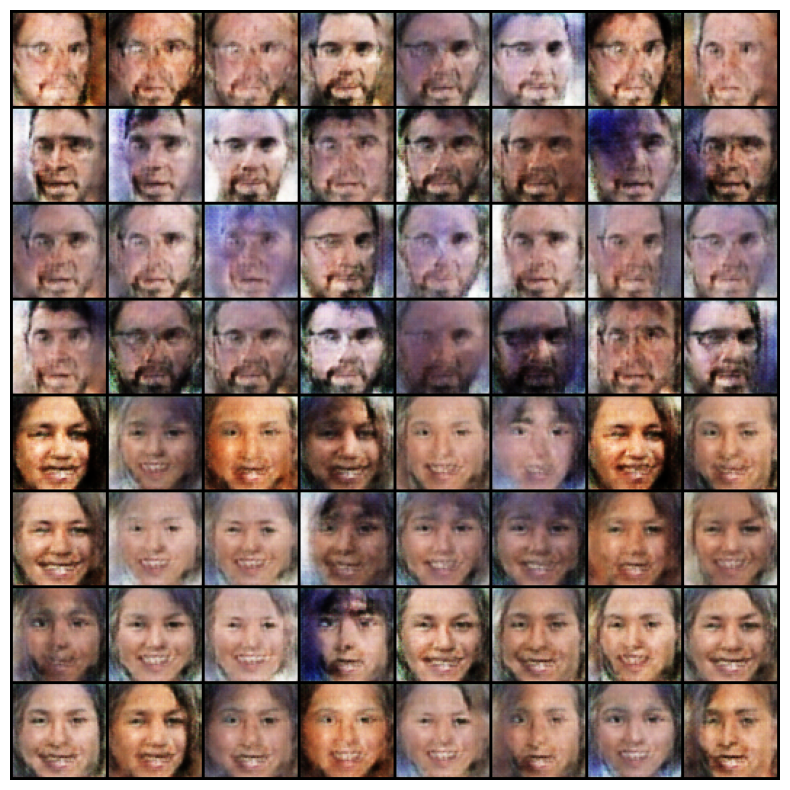

EPOCH: 7.000  g_loss: 4.598  d_loss: 0.511  (319.70s - 822.10s remaining)


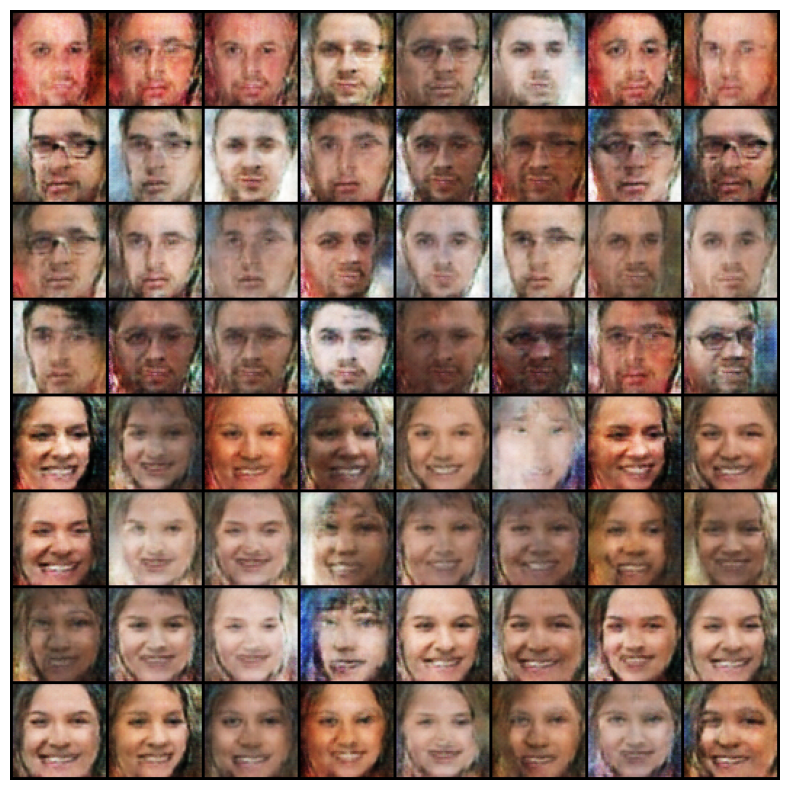

EPOCH: 8.000  g_loss: 4.469  d_loss: 0.497  (369.78s - 785.79s remaining)


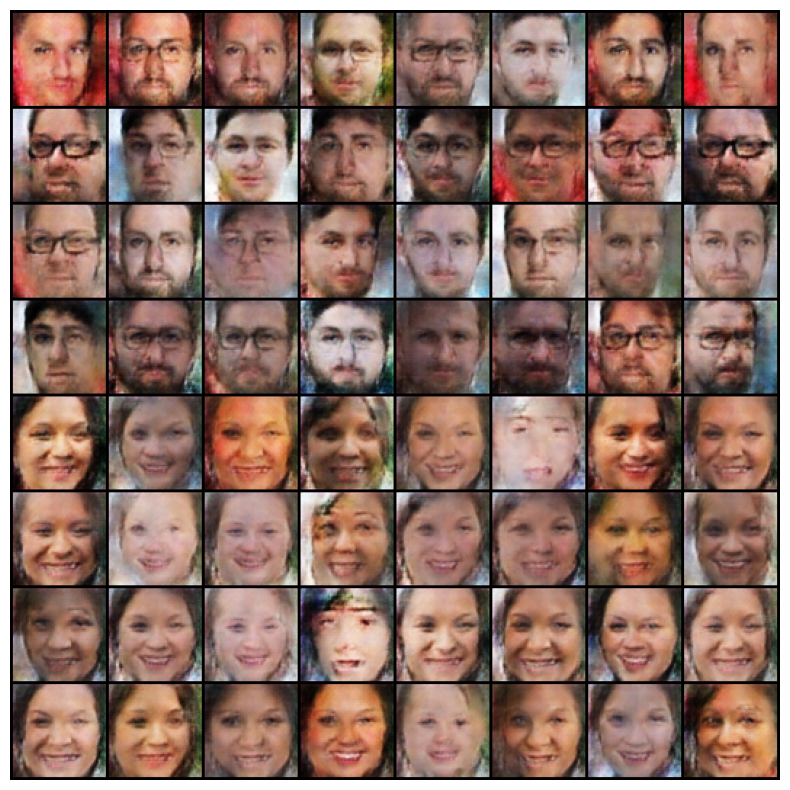

EPOCH: 9.000  g_loss: 4.302  d_loss: 0.500  (421.37s - 749.11s remaining)


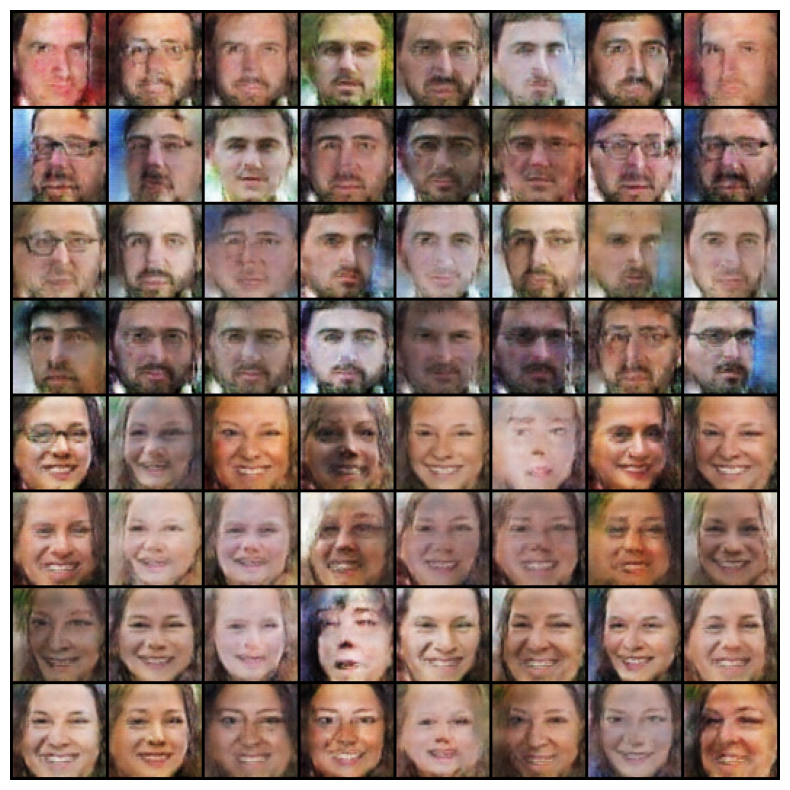

EPOCH: 10.000  g_loss: 4.229  d_loss: 0.494  (475.66s - 713.49s remaining)


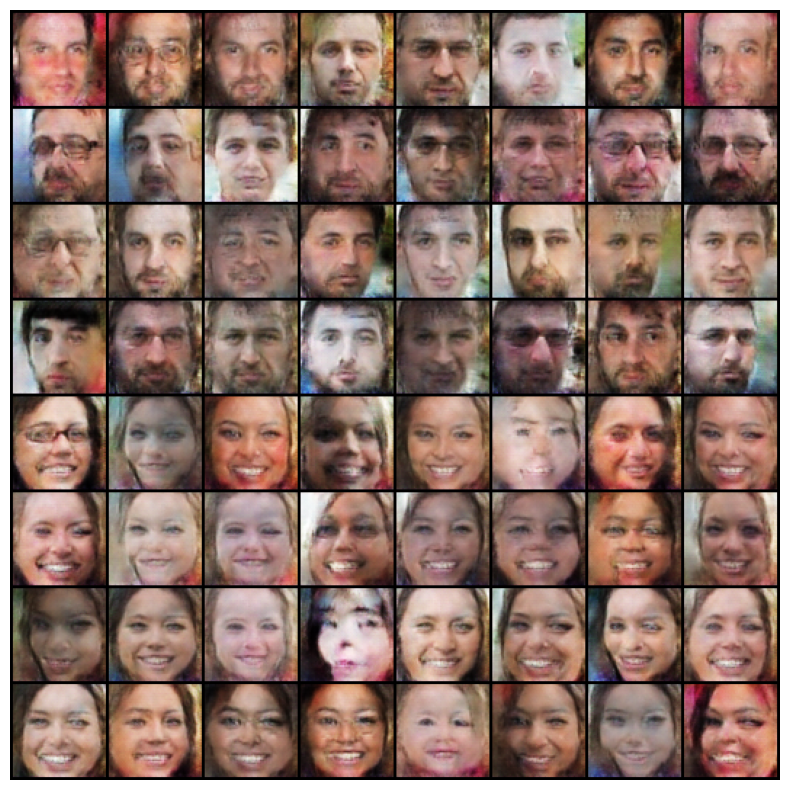

EPOCH: 11.000  g_loss: 4.215  d_loss: 0.482  (529.63s - 674.08s remaining)


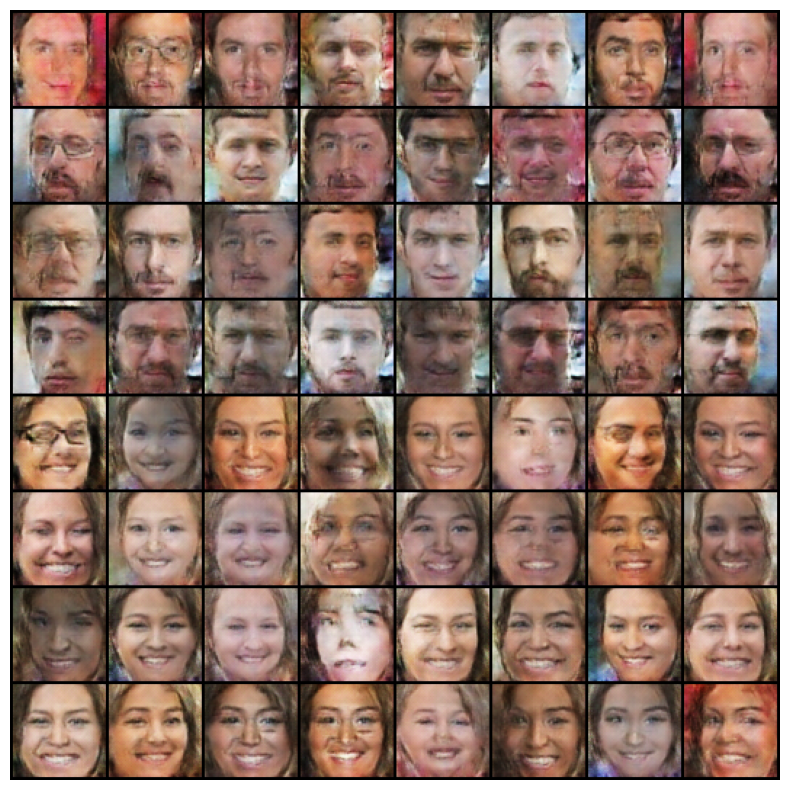

EPOCH: 12.000  g_loss: 4.194  d_loss: 0.474  (583.35s - 631.96s remaining)


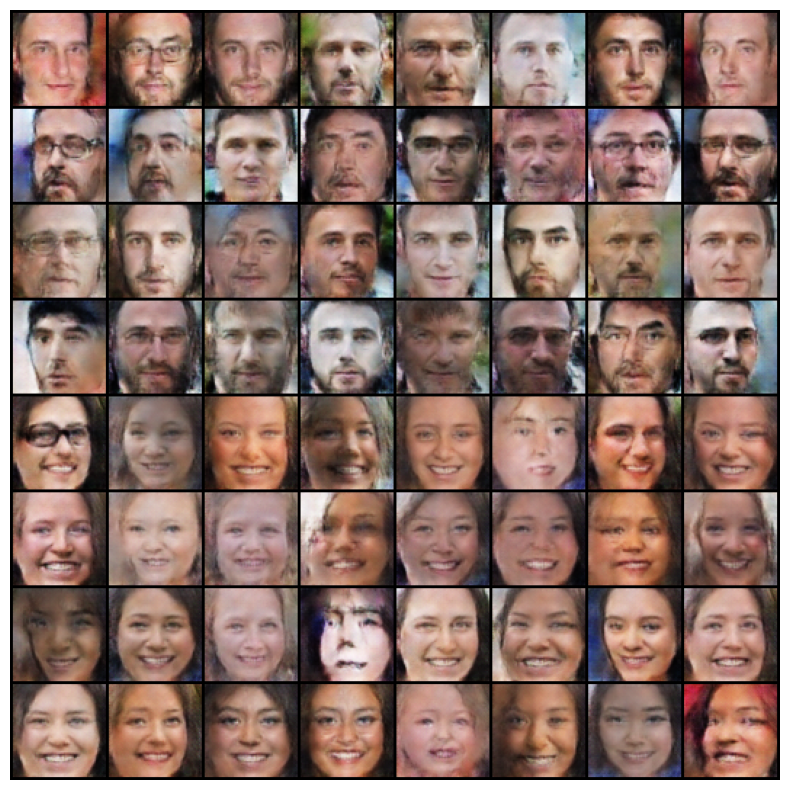

EPOCH: 13.000  g_loss: 4.164  d_loss: 0.454  (637.57s - 588.53s remaining)


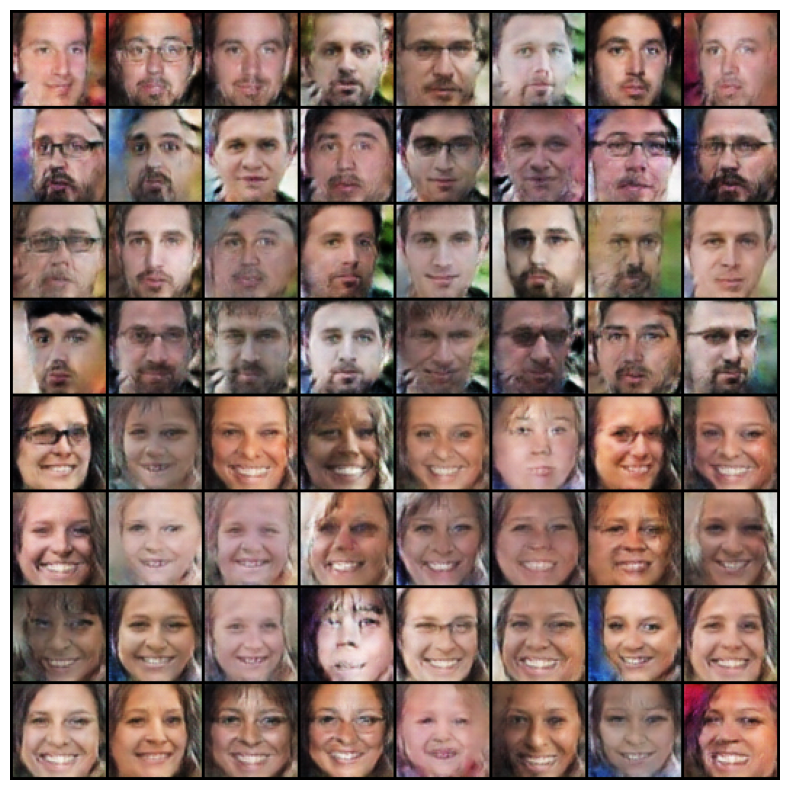

EPOCH: 14.000  g_loss: 4.111  d_loss: 0.486  (691.86s - 543.60s remaining)


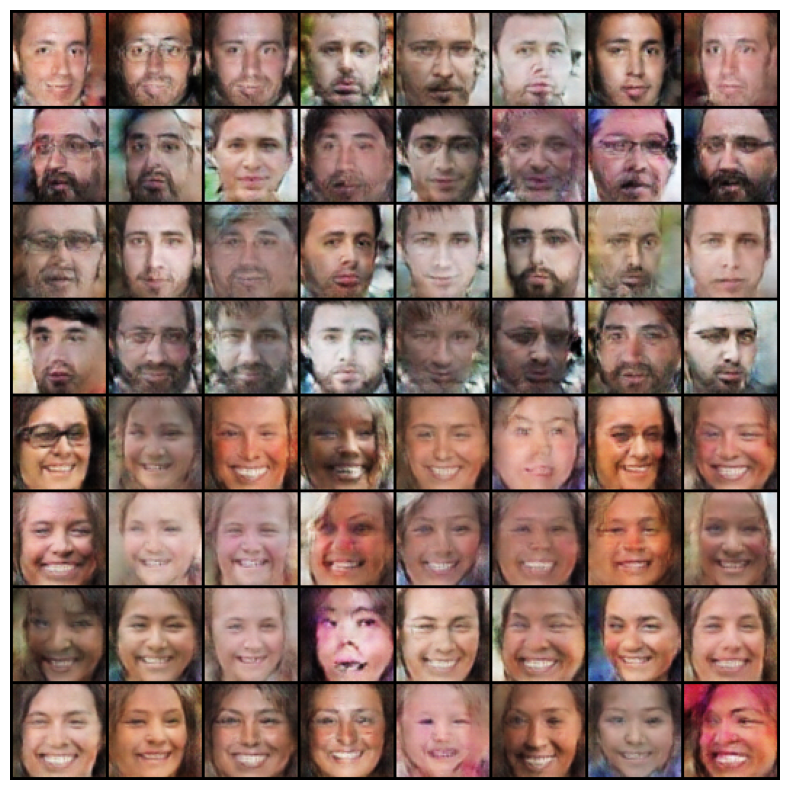

EPOCH: 15.000  g_loss: 4.126  d_loss: 0.412  (746.07s - 497.38s remaining)


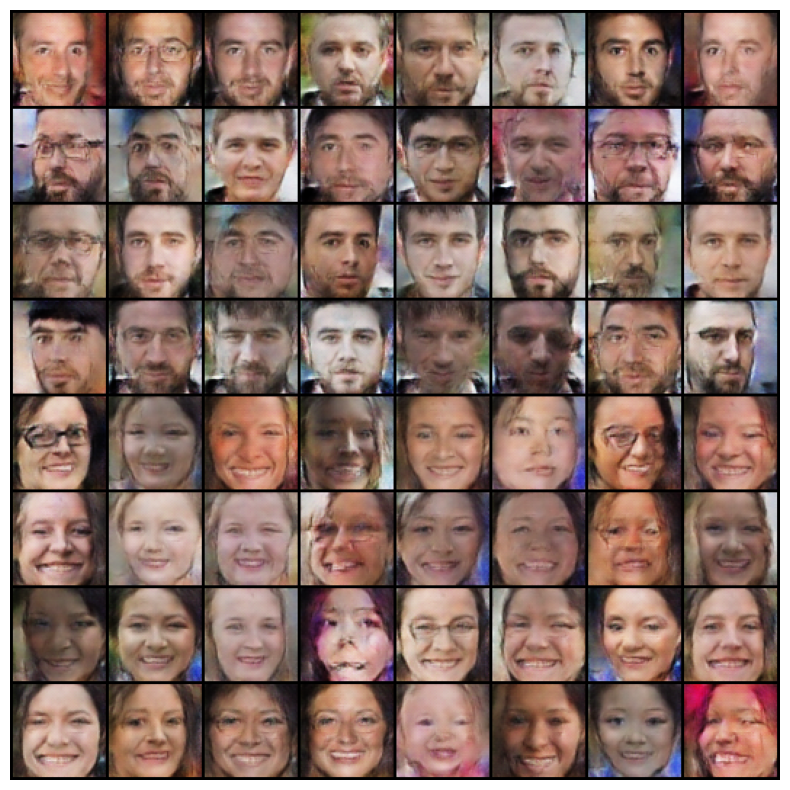

EPOCH: 16.000  g_loss: 4.244  d_loss: 0.426  (800.33s - 450.18s remaining)


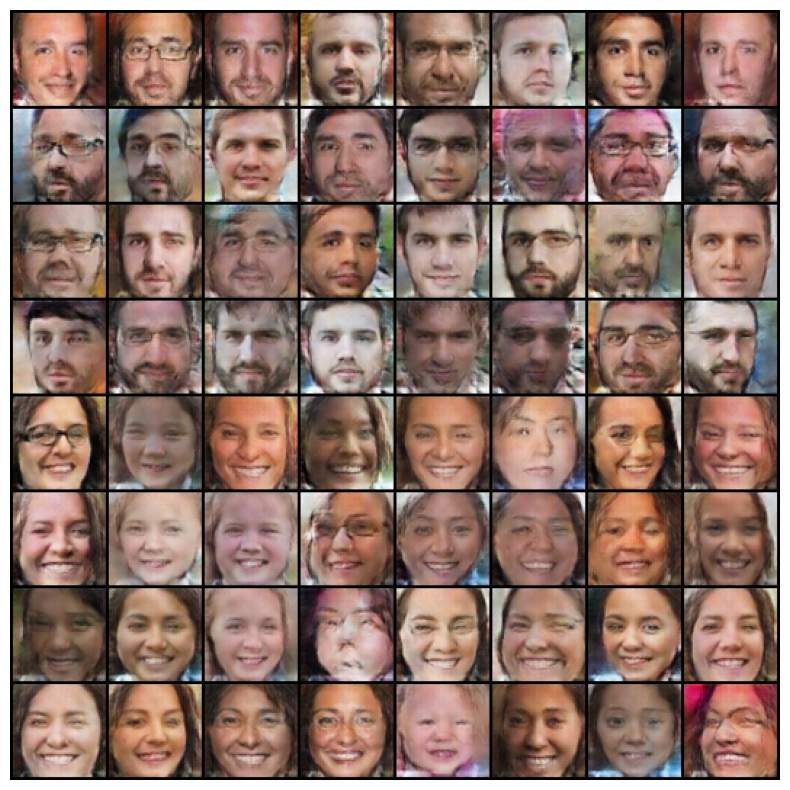

EPOCH: 17.000  g_loss: 4.336  d_loss: 0.387  (854.51s - 402.12s remaining)


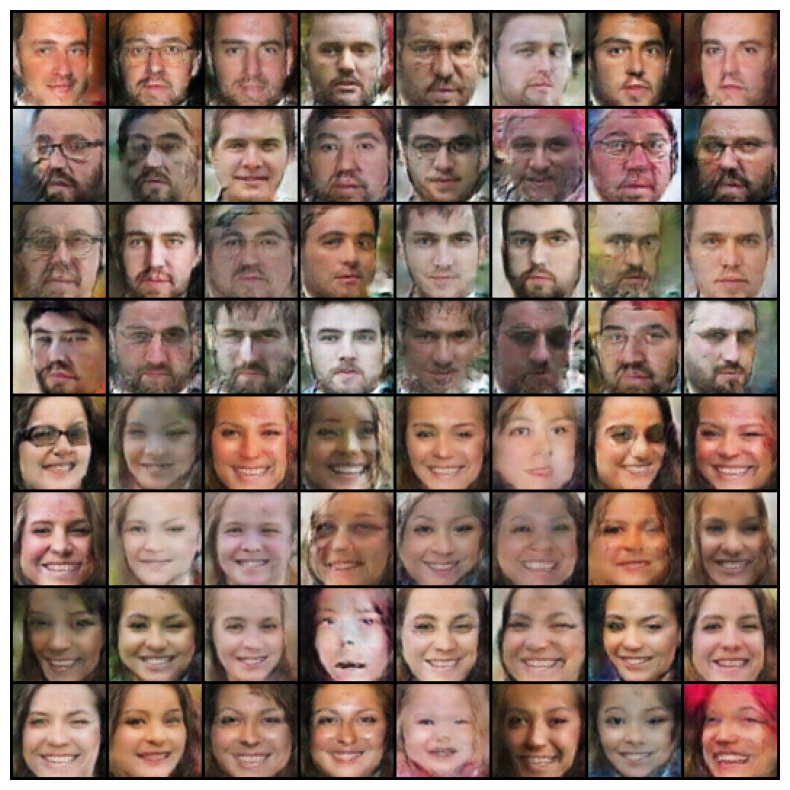

EPOCH: 18.000  g_loss: 4.360  d_loss: 0.403  (908.25s - 353.21s remaining)


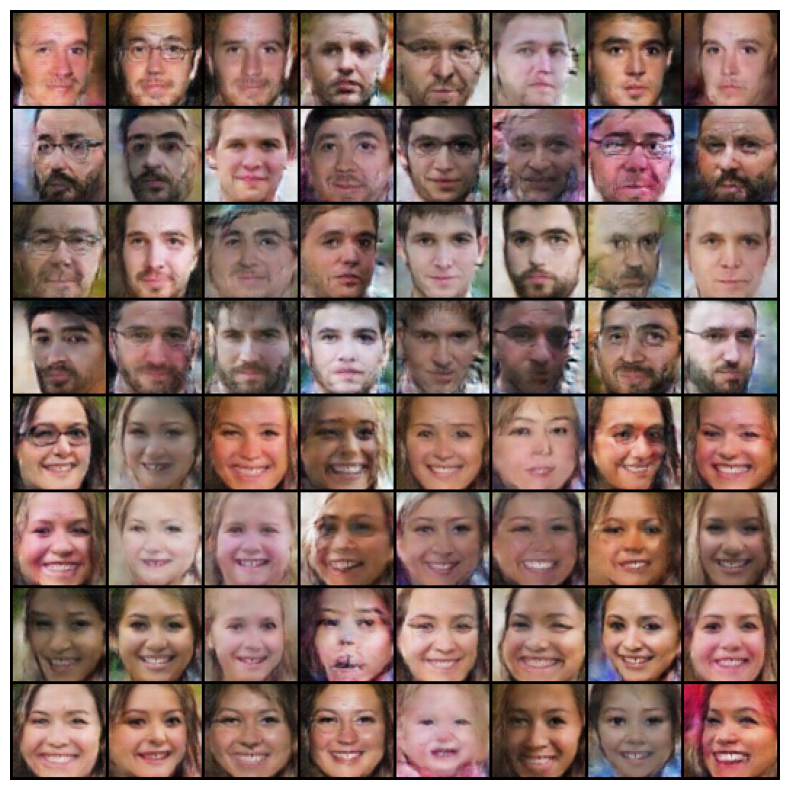

EPOCH: 19.000  g_loss: 4.312  d_loss: 0.413  (962.32s - 303.89s remaining)


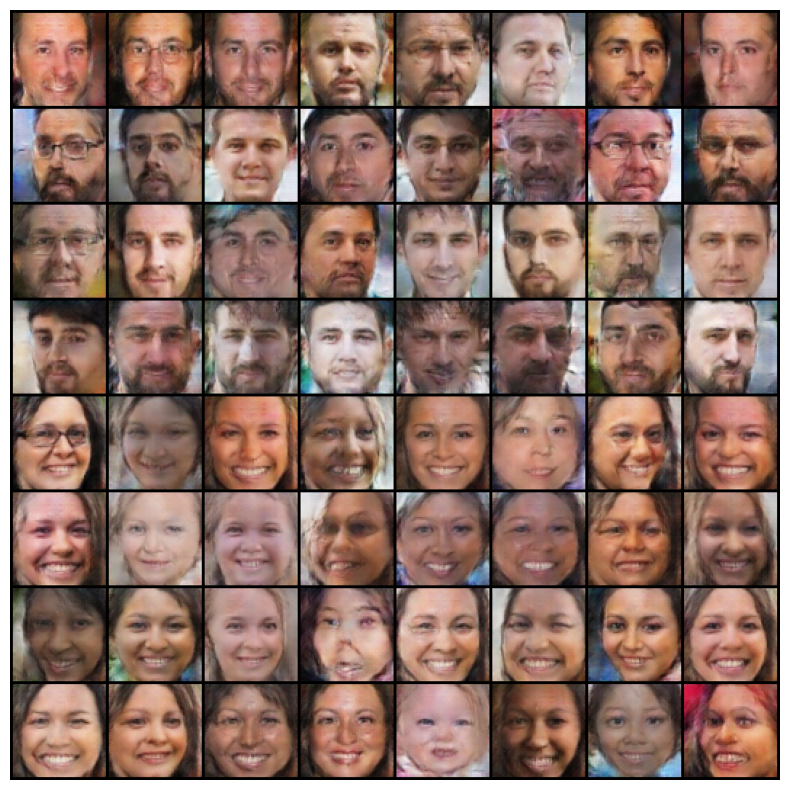

EPOCH: 20.000  g_loss: 4.415  d_loss: 0.351  (1016.64s - 254.16s remaining)


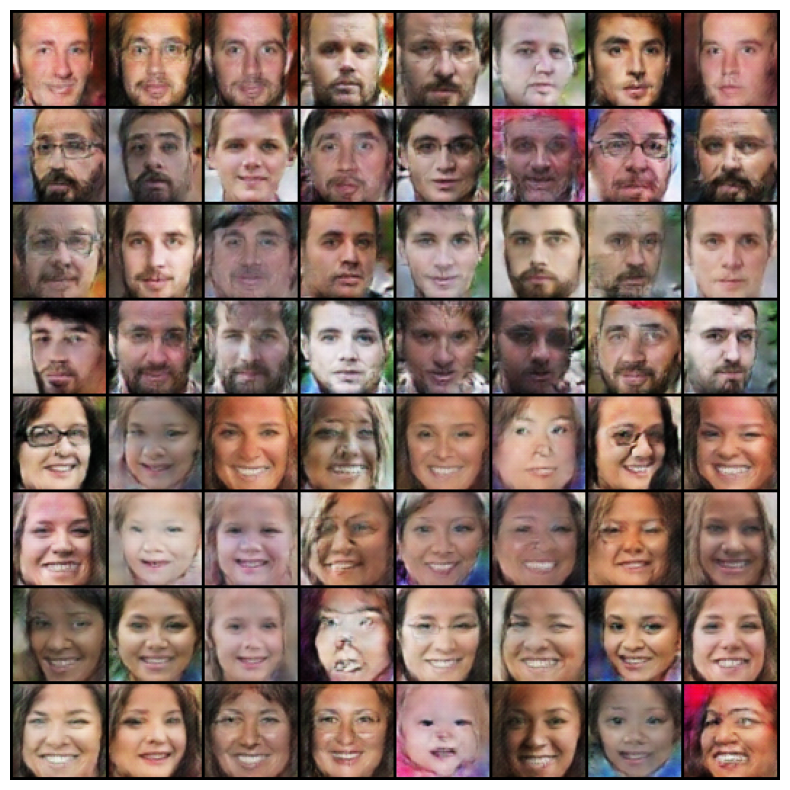

EPOCH: 21.000  g_loss: 4.542  d_loss: 0.353  (1070.54s - 203.91s remaining)


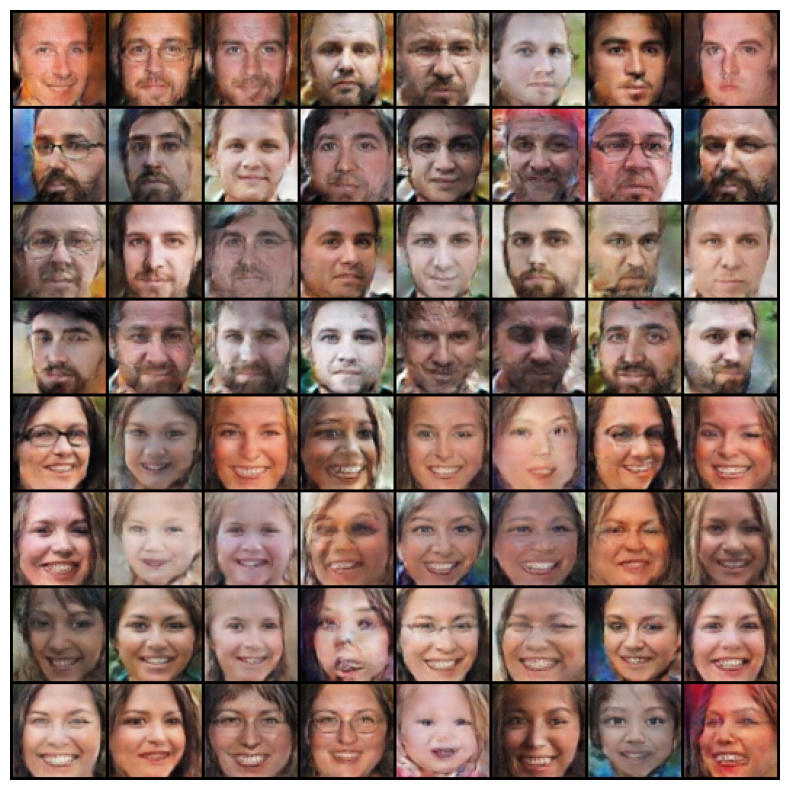

EPOCH: 22.000  g_loss: 4.403  d_loss: 0.382  (1124.57s - 153.35s remaining)


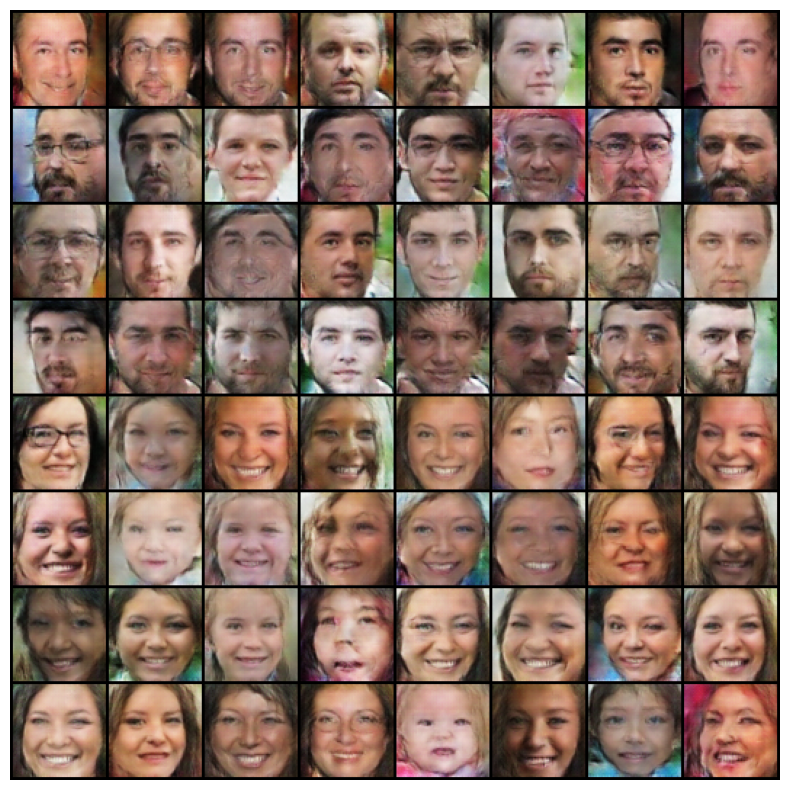

EPOCH: 23.000  g_loss: 4.482  d_loss: 0.367  (1178.60s - 102.49s remaining)


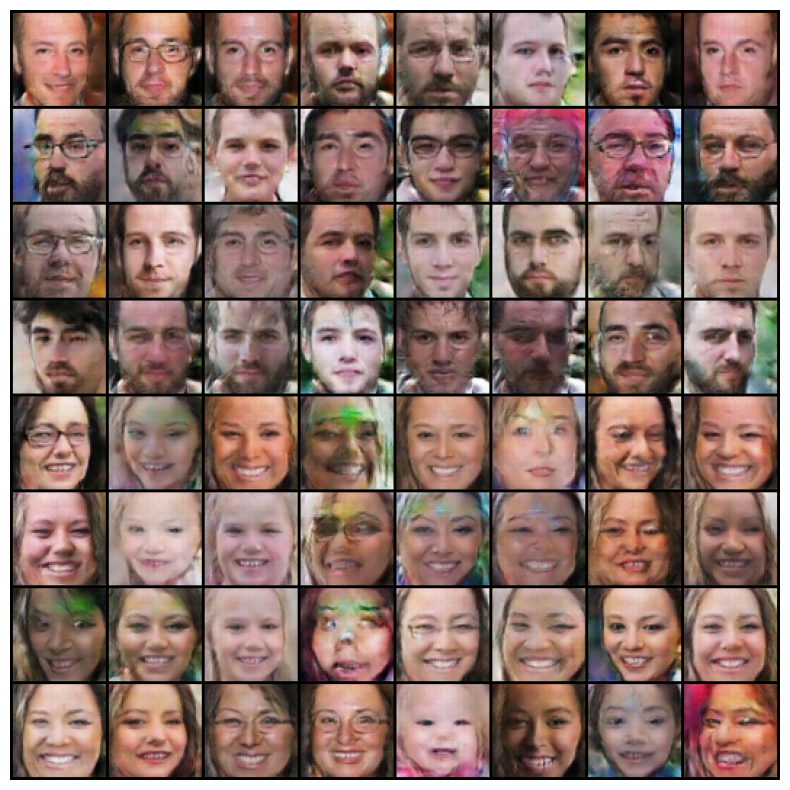

EPOCH: 24.000  g_loss: 4.493  d_loss: 0.306  (1232.93s - 51.37s remaining)


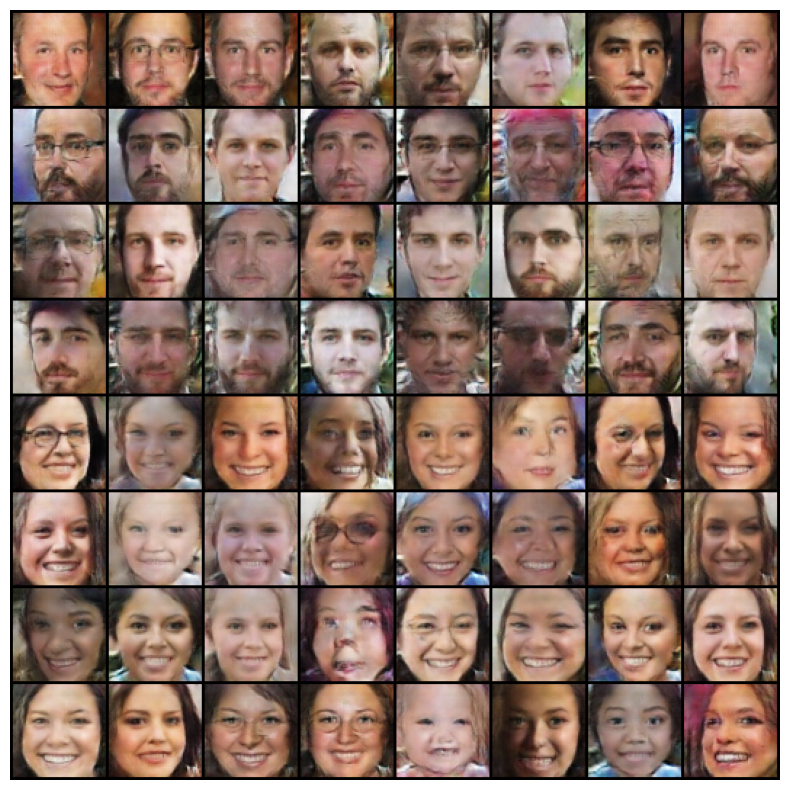

EPOCH: 25.000  g_loss: 4.499  d_loss: 0.370  (1287.18s - 0.00s remaining)


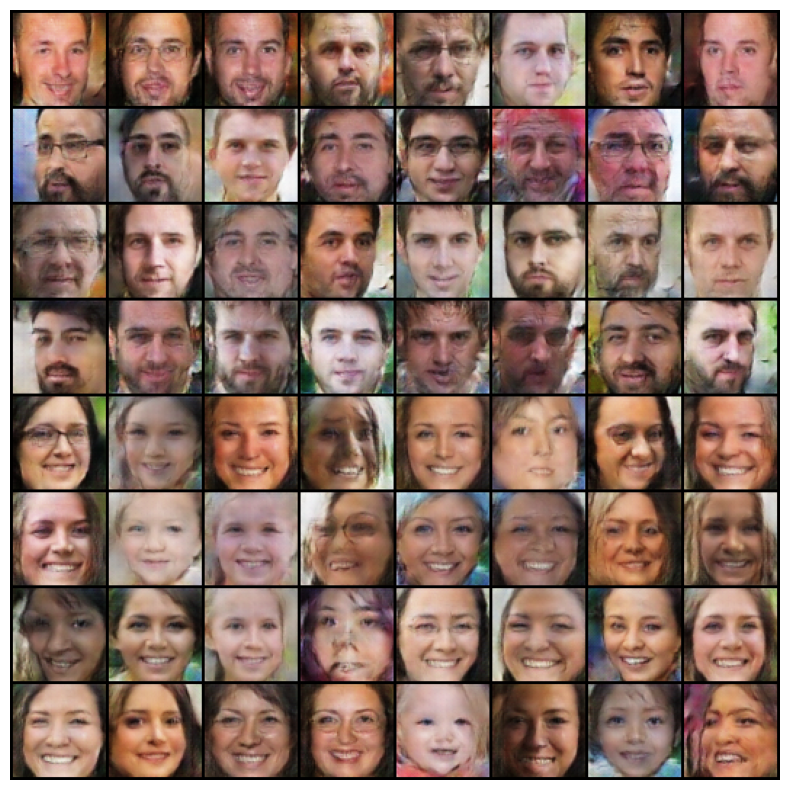

In [ ]:
log = Report(n_epochs)
for epoch in range(n_epochs):
    N = len(dataloader)
    for bx, (images, labels) in enumerate(dataloader):
        real_data, real_labels = images.to(device), labels.to(device)
        fake_labels = torch.LongTensor(np.random.randint(0, 2, len(real_data))).to(device)
        fake_data = generator(noise(len(real_data)), fake_labels)
        fake_data = fake_data.detach()
        d_loss = discriminator_train_step(real_data, real_labels, fake_data, fake_labels)
        fake_labels = torch.LongTensor(np.random.randint(0, 2, len(real_data))).to(device)
        fake_data = generator(noise(len(real_data)), fake_labels).to(device)
        g_loss = generator_train_step(fake_data, fake_labels)
        pos = epoch + (1+bx)/N
        log.record(pos, d_loss=d_loss.detach(), g_loss=g_loss.detach(), end='\r')
    log.report_avgs(epoch+1)
    with torch.no_grad():
        fake = generator(fixed_noise, fixed_fake_labels).detach().cpu()
        imgs = vutils.make_grid(fake, padding=2, normalize=True).permute(1,2,0)
        img_list.append(imgs)
        show(imgs, sz=10)
